In [1]:
import os
import nibabel
import pydicom
import numpy as np
import sys
import glob
import matplotlib.pyplot as plt
from matplotlib import colors
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import cv2
import h5py
import keras
import tensorflow as tf
from keras import backend as K
import h5py
from skimage import exposure

smoothDSC = np.finfo(float).eps

cmap = colors.ListedColormap(['red', 'green', 'blue', 'yellow', 'cyan', 'orange', "magenta"])


def sample_stack(stack, segmenation, rows=8, cols=8, start_with=20, show_every=2):
    # Funktion, um MRT-Aufnahme (stack) und dazugehörige Segmentierung als Sammlung zu plotten
    bounds = [0, 1, 2, 3, 4, 5, 6, 7]
    norm = colors.BoundaryNorm(bounds, cmap.N)
    fig, ax = plt.subplots(rows, cols, figsize=[30, 30])
    for i in range(rows * cols):
        ind = start_with + i * show_every
        ax[int(i / rows), int(i % rows)].set_title('slice %d' % ind)
        ax[int(i / rows), int(i % rows)].imshow(stack[ind], cmap='gray', interpolation='none')
        ax[int(i / rows), int(i % rows)].imshow(np.ma.masked_where(segmenation[ind] == 0, segmenation[ind]),
                                                interpolation='nearest', origin='lower', cmap=cmap, norm=norm)
        ax[int(i / rows), int(i % rows)].axis('off')
    plt.show()


# DICE Coeffizient für 3 Klassen Segmentierung
def dice_coef(y_true, y_pred, smooth=smoothDSC):
    class_num = 2
    for i in range(class_num):
        y_true_f = K.flatten(y_true[:, :, :, i])
        y_pred_f = K.flatten(y_pred[:, :, :, i])
        intersection = K.sum(y_true_f * y_pred_f)
        loss = ((2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth))
        if i == 0:
            total_loss = loss
        else:
            total_loss = total_loss + loss
    total_loss = total_loss / class_num
    return total_loss


# Inspiriert durch https://github.com/keras-team/keras/issues/9395

# DICE Coefficient für Mensiskus medialis
def dice_coef_medial(y_true, y_pred, epsilon=np.finfo(float).eps):
    y_true_f = K.flatten(y_true[:, :, :, 5])
    y_pred_f = K.flatten(y_pred[:, :, :, 5])
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + epsilon) / (K.sum(y_true_f) + K.sum(y_pred_f) + epsilon)


def dice_coef_lateral(y_true, y_pred, epsilon=np.finfo(float).eps):
    y_true_f = K.flatten(y_true[:, :, :, 6])
    y_pred_f = K.flatten(y_pred[:, :, :, 6])
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + epsilon) / (K.sum(y_true_f) + K.sum(y_pred_f) + epsilon)


def dice_coef_tibia(y_true, y_pred, epsilon=np.finfo(float).eps):
    y_true_f = K.flatten(y_true[:, :, :, 3])
    y_pred_f = K.flatten(y_pred[:, :, :, 3])
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + epsilon) / (K.sum(y_true_f) + K.sum(y_pred_f) + epsilon)


def dice_coef_femur(y_true, y_pred, epsilon=np.finfo(float).eps):
    y_true_f = K.flatten(y_true[:, :, :, 1])
    y_pred_f = K.flatten(y_pred[:, :, :, 1])
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + epsilon) / (K.sum(y_true_f) + K.sum(y_pred_f) + epsilon)


def dice_coef_C_tibia(y_true, y_pred, epsilon=np.finfo(float).eps):
    y_true_f = K.flatten(y_true[:, :, :, 4])
    y_pred_f = K.flatten(y_pred[:, :, :, 4])
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + epsilon) / (K.sum(y_true_f) + K.sum(y_pred_f) + epsilon)


def dice_coef_C_femur(y_true, y_pred, epsilon=np.finfo(float).eps):
    y_true_f = K.flatten(y_true[:, :, :, 2])
    y_pred_f = K.flatten(y_pred[:, :, :, 2])
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + epsilon) / (K.sum(y_true_f) + K.sum(y_pred_f) + epsilon)


# Präzsion
def precision(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision


# Sensitivität
def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())


# Spezifität
def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1 - y_true) * (1 - y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1 - y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())


DATA_PATH = "../../data/"
TRAIN_DATASET_PATH = DATA_PATH + "training_data/OAI_single/"
predictions = []
predictions.append(np.zeros((160, 384, 384)))
with h5py.File(TRAIN_DATASET_PATH + "MenisKI21_Prediction_25_Femur.h5", 'r') as hf:
    prediction_ids = [s[:-4] for s in list(hf.keys()) if "Test" in s.split("_") and "dcm" in s.split("_")]


    for [index, current_seg] in enumerate(["Femur", "Femur_C_", "Tibia_", "Tibia_C_", "Men_Med_", "Men_Lat_"], start=1):

        model_test = keras.models.load_model(TRAIN_DATASET_PATH + "models/model_singles_" + current_seg + ".h5",
                                             custom_objects={'accuracy': tf.keras.metrics.MeanIoU(num_classes=2),
                                                             "dice_coef": dice_coef,
                                                             "dice_coef_medial": dice_coef_medial,
                                                             "dice_coef_lateral": dice_coef_lateral,
                                                             "precision": precision,
                                                             "sensitivity": sensitivity,
                                                             "specificity": specificity,
                                                             },
                                             compile=False)
        model_test.compile()

        to_pred = hf[prediction_ids[1] + "_dcm"][:]
        to_pred = np.array(to_pred)
        pred = model_test.predict(to_pred, batch_size=15, verbose=1)

        res = np.argmax(pred, axis=3)
        predictions.append(res)
    con = np.stack(predictions, axis=3)

    # sample_stack(hf[prediction_ids[1] + '_dcm'][:], predictions[1], rows=2, cols=2, start_with=40, show_every=2)
    # sample_stack(hf[prediction_ids[1] + '_dcm'][:], predictions[2], rows=2, cols=2, start_with=40, show_every=2)
    # sample_stack(hf[prediction_ids[1] + '_dcm'][:], predictions[3], rows=2, cols=2, start_with=40, show_every=2)
    # sample_stack(hf[prediction_ids[1] + '_dcm'][:], predictions[4], rows=2, cols=2, start_with=40, show_every=2)
    # sample_stack(hf[prediction_ids[1] + '_dcm'][:], predictions[5], rows=2, cols=2, start_with=40, show_every=2)
    # sample_stack(hf[prediction_ids[1] + '_dcm'][:], predictions[6], rows=2, cols=2, start_with=40, show_every=2)


11/11 [==============================] - 43s 4s/step


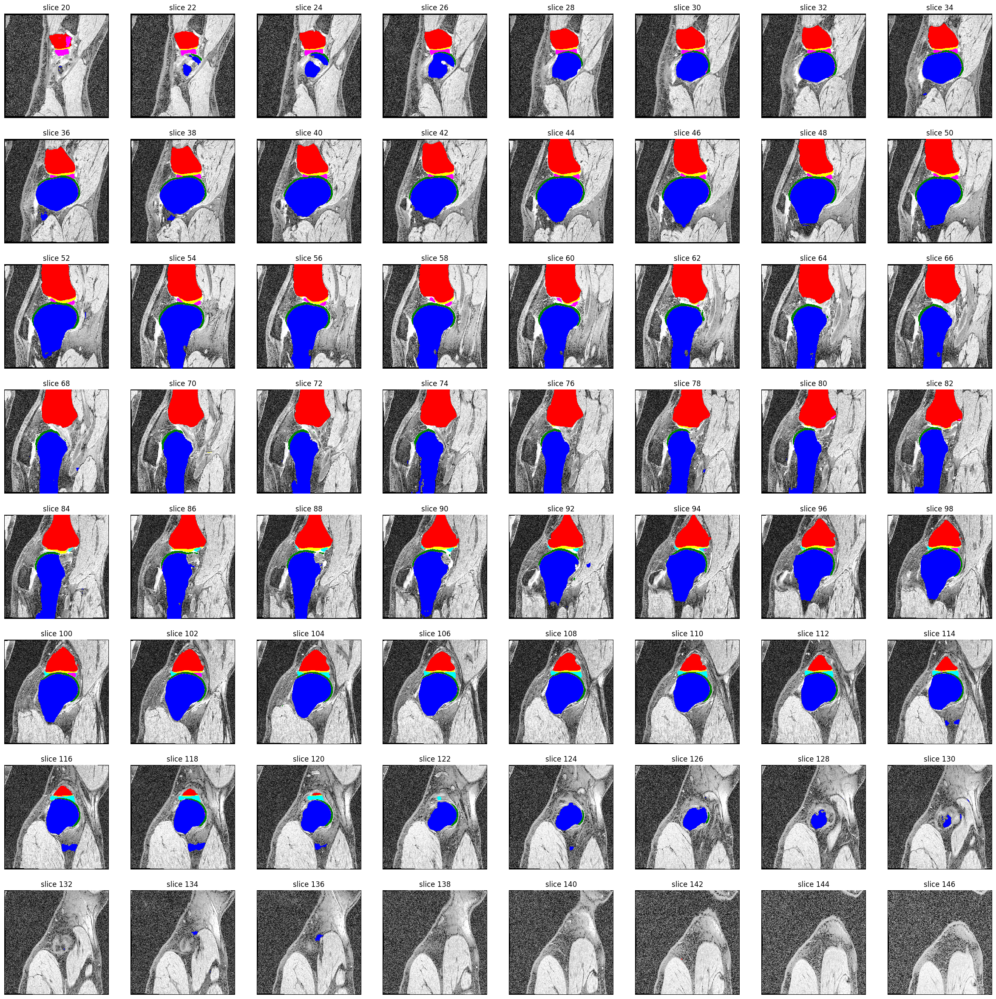

ratio:
0.004732512965439678


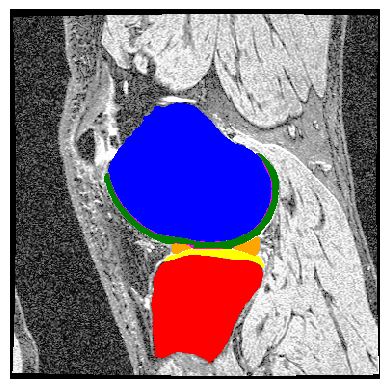

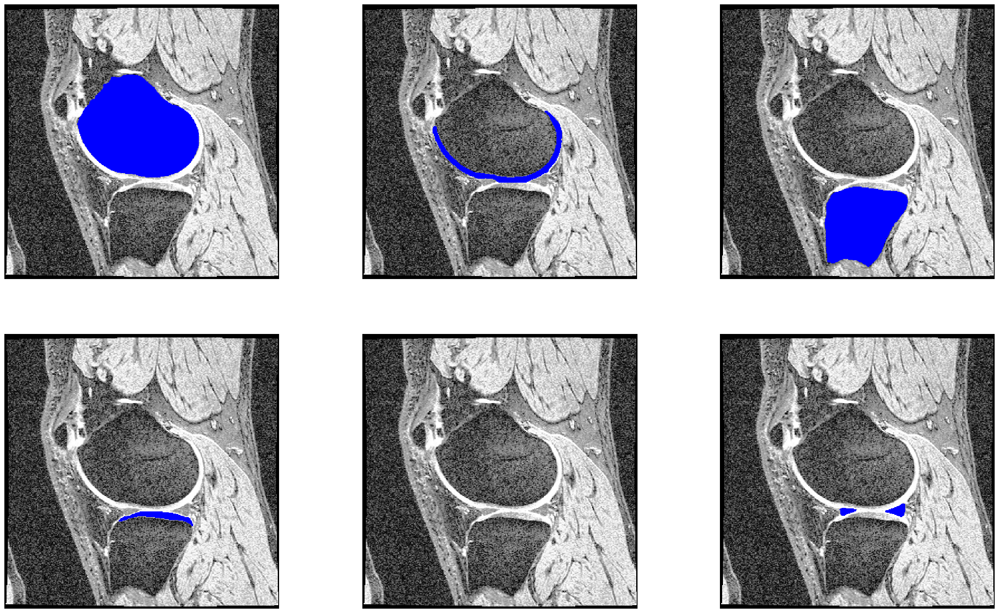

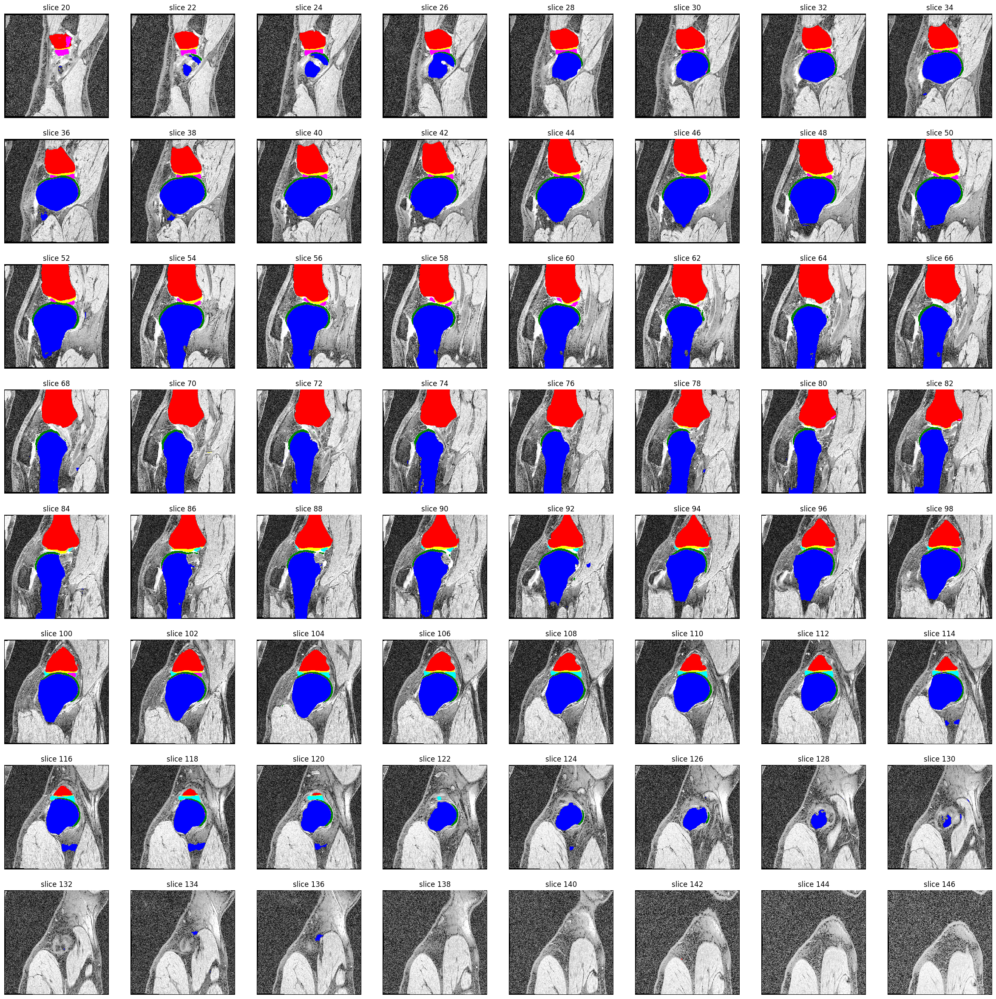

ratio:
0.004732512965439678


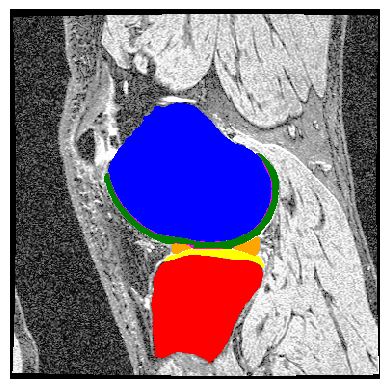

In [3]:
with h5py.File(TRAIN_DATASET_PATH + "MenisKI21_Prediction_25_Femur.h5", 'r') as hf:
    cmap = colors.ListedColormap(['white', 'blue', 'green', 'red', 'yellow', 'cyan', 'orange', "magenta"])
    bounds = [0, 1, 2, 3, 4, 5, 6, 7,8]
    fig, ax = plt.subplots(2, 3, figsize=[30, 18])
    norm = colors.BoundaryNorm(bounds, cmap.N)
    img = np.flip(hf[prediction_ids[1] + '_dcm'][40], axis=0)
    ind = 1
    for i in range(2):
        for k in range(3):
            segmentation_specific = np.flip(predictions[ind][40], axis=0)
            ax[i, k].imshow(img, cmap='gray', interpolation='none')
            ax[i, k].imshow(np.ma.masked_where(segmentation_specific == 0, segmentation_specific),interpolation='nearest', origin='lower', cmap=cmap, norm=norm)
            ax[i, k].axis('off')
            ind = ind+1
    plt.show()
    shape = np.shape(con)
    seg = np.zeros((160, 384, 384, 1))
    for k in range(shape[0]):
        for i in range(shape[1]):
            for j in range(shape[2]):
                for m in range(shape[3]):
                    if con[k, i, j, m] != 0:
                        if seg[k, i, j] == 0:
                            seg[k, i, j] = m
                        else:
                            seg[k, i, j] = 7

    sample_stack(hf[prediction_ids[1] + '_dcm'][:], seg, rows=8, cols=8, start_with=20, show_every=2)

    double_pixels = np.count_nonzero(seg == 7)
    number_pixels = np.count_nonzero(seg)
    ratio = double_pixels / number_pixels

    print("ratio:")
    print(ratio)

    norm = colors.BoundaryNorm(bounds, cmap.N)
    segmentation_all = np.flip(seg[40], axis=0)
    plt.figure()
    plt.imshow(img, cmap='gray', interpolation='none')
    plt.imshow(np.ma.masked_where(segmentation_all == 0, segmentation_all),interpolation='nearest', origin='lower', cmap=cmap, norm=norm)
    plt.axis('off')
    plt.show()